In [ ]:
import numpy as np, pandas as pd, os, cv2
from matplotlib import pyplot as plt, animation
from PIL import Image
from IPython.display import HTML

import torch , torchvision
from torch import nn, optim
from torchvision import transforms as T
from torchvision.datasets import ImageFolder
from torchvision.utils import save_image, make_grid
from torch.utils.data import Dataset, DataLoader

!pip install torchsummary
from torchsummary import summary

In [ ]:
batch_size = 2048
width = 64

latent_channels = 200
latent_width = 1
channels = 3
width = 64
n_feat = 64

lr = 0.0002
epochs = 50

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
import zipfile
zip_ref=zipfile.ZipFile('/content/drive/MyDrive/data.zip','r')
zip_ref.extractall('content/dataset')
zip_ref.close()

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
folder3 = '/content/content/dataset/data'

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else "cpu")

transform = T.Compose([
    T.Resize((width , width )),
    T.ToTensor(),
    T.RandomHorizontalFlip(),
    T.Normalize((0.5, 0.5, 0.5) , (0.5, 0.5, 0.5))
])

In [ ]:

d3 = ImageFolder('/content/content/dataset', transform = transform)


In [ ]:
dataset = d3
data_loader = DataLoader(
    dataset,
    batch_size = batch_size,
    drop_last = True,
    shuffle = True
)

In [ ]:
def images(x : torch.Tensor ,show = True, save = False, path : str = None, nrow = 0):
    img = x.detach().cpu()
    if nrow == 0:
        nrow = int(len(img) ** 0.5)

    if show:
        plt.imshow(make_grid(img, nrow = nrow, normalize = True).permute(1,2, 0))
        plt.axis('off')
        plt.show()

    if save and path is not None:
        save_image(img, path, nrow = nrow, normalize = True)

In [ ]:
def animate_images(folder, title = None, reverse = False):
    images = sorted(os.listdir(folder))

    if reverse:
        images.reverse()

    images = [Image.open(os.path.join(folder, i)) for i in images if i.endswith('.png')]
    fig, ax = plt.subplots(figsize = (4,4))
    ax.axis('off')

    if title is not None:
        ax.set_title(title)
    i = [[plt.imshow(img, animated = True)] for img in images]
    ani = animation.ArtistAnimation(fig, i, interval = 100, repeat_delay = 1000, blit = True)
    plt.close()
    return HTML(ani.to_jshtml())

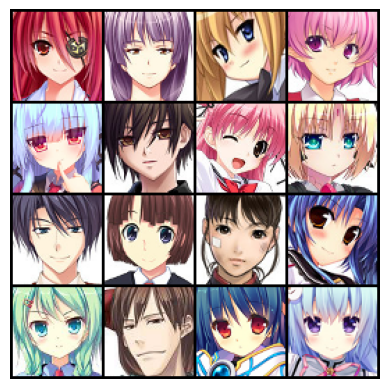

In [ ]:
for im, l in data_loader:
    im = im[:16]
    images(im)
    break

In [ ]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        torch.nn.init.normal_(m.weight, 1.0, 0.02)
        torch.nn.init.zeros_(m.bias)

In [ ]:
def conv_block(in_channels, out_channels, kernal_size = 4, stride = 2, padding = 1, relu = True, BN = True, transp = False):
    layers = [nn.Conv2d(in_channels, out_channels, kernal_size, stride, padding, bias = False)]
    if transp:
        layers[0] = (nn.ConvTranspose2d(in_channels, out_channels, kernal_size, stride, padding, bias = False))
    if BN:
        layers.append(nn.BatchNorm2d(out_channels))
    if relu:
        if transp:
            layers.append(nn.ReLU())
        else:
            layers.append(nn.LeakyReLU(0.2))
    return layers

In [ ]:
# input (-1 , 200,1 , 1)
generator = nn.Sequential(
    *conv_block(latent_channels, n_feat * 8 ,4,1,0, transp = True ), # ( 64 * 8, 4, 4)
    *conv_block(n_feat * 8 , n_feat * 4, transp = True ), # ( 64 * 4, 8, 8)
    *conv_block(n_feat * 4 , n_feat * 2, transp = True ), # ( 64 * 2, 16, 16)
    *conv_block(n_feat * 2 , n_feat, transp = True ), # ( 64 * 1, 32, 32)
    *conv_block(n_feat , channels, transp = True, relu = False, BN = False), # ( 3, 64, 64)
    nn.Tanh()
)
generator.apply(weights_init)
generator = generator.to(device)

summary(generator, (latent_channels,latent_width,latent_width))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 512, 4, 4]       1,638,400
       BatchNorm2d-2            [-1, 512, 4, 4]           1,024
              ReLU-3            [-1, 512, 4, 4]               0
   ConvTranspose2d-4            [-1, 256, 8, 8]       2,097,152
       BatchNorm2d-5            [-1, 256, 8, 8]             512
              ReLU-6            [-1, 256, 8, 8]               0
   ConvTranspose2d-7          [-1, 128, 16, 16]         524,288
       BatchNorm2d-8          [-1, 128, 16, 16]             256
              ReLU-9          [-1, 128, 16, 16]               0
  ConvTranspose2d-10           [-1, 64, 32, 32]         131,072
      BatchNorm2d-11           [-1, 64, 32, 32]             128
             ReLU-12           [-1, 64, 32, 32]               0
  ConvTranspose2d-13            [-1, 3, 64, 64]           3,072
             Tanh-14            [-1, 3,

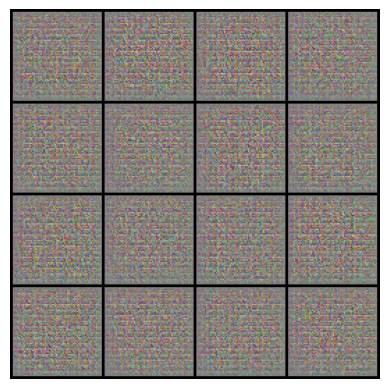

In [ ]:
def get_noise(n_samples = batch_size):
    return (torch.randn(n_samples, latent_channels, latent_width, latent_width , device = device))

def generate(n_samples = batch_size):
    return generator(get_noise(n_samples))

images(generate(16))

In [ ]:
#  Input shape ( 3, 64, 64)
discriminator = nn.Sequential(
    *conv_block(channels, n_feat ), # (64 , 32, 32)
    *conv_block(n_feat, n_feat * 2), # (64 * 2, 16 , 16)
    *conv_block(n_feat * 2, n_feat * 4), # (64 * 4, 8, 8)
    *conv_block(n_feat * 4, n_feat * 8), # (64 * 8, 4 , 4)
    *conv_block(n_feat * 8, 1, 4, 1, 0, relu = False, BN = False), # (1, 1, 1),
    nn.Sigmoid(), nn.Flatten(),
)
discriminator.apply(weights_init)
discriminator = discriminator.to(device)

summary(discriminator, (channels,width,width))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 32, 32]           3,072
       BatchNorm2d-2           [-1, 64, 32, 32]             128
         LeakyReLU-3           [-1, 64, 32, 32]               0
            Conv2d-4          [-1, 128, 16, 16]         131,072
       BatchNorm2d-5          [-1, 128, 16, 16]             256
         LeakyReLU-6          [-1, 128, 16, 16]               0
            Conv2d-7            [-1, 256, 8, 8]         524,288
       BatchNorm2d-8            [-1, 256, 8, 8]             512
         LeakyReLU-9            [-1, 256, 8, 8]               0
           Conv2d-10            [-1, 512, 4, 4]       2,097,152
      BatchNorm2d-11            [-1, 512, 4, 4]           1,024
        LeakyReLU-12            [-1, 512, 4, 4]               0
           Conv2d-13              [-1, 1, 1, 1]           8,192
          Sigmoid-14              [-1, 

In [ ]:
generator_optim = optim.Adam(generator.parameters(), lr = lr, betas = (0.5, 0.999))
discriminator_optim = optim.Adam(discriminator.parameters(), lr = lr, betas = (0.5, 0.999),)


criterion = nn.BCELoss()
history = []

g_losses = []
d_losses = []
r_scores = []
f_scores = []

fixed_noise = get_noise(64)
tr = 'training_images'
checkpoints = 'model_checkpoint'
os.makedirs(checkpoints, exist_ok = True)
os.makedirs(tr, exist_ok = True)

In [ ]:
def train_generator():
    generator.train()

    fake_images = generate()
    fake_pred = discriminator(fake_images)
    fake_labels = torch.ones_like(fake_pred)

    generator_loss = criterion(fake_pred, fake_labels)

    generator_optim.zero_grad()
    generator_loss.backward()
    generator_optim.step()

    return generator_loss.detach().item()

In [ ]:
def train_discriminator(real_images):
    discriminator.train()

    real_pred = discriminator(real_images)
    real_labels = torch.ones_like(real_pred)

    fake_pred = discriminator(generate() )
    fake_labels = torch.zeros_like(fake_pred)

    real_loss = criterion(real_pred, real_labels)
    fake_loss = criterion(fake_pred, fake_labels)

    discriminator_loss = (real_loss + fake_loss)

    discriminator_optim.zero_grad()
    discriminator_loss.backward()
    discriminator_optim.step()

    return discriminator_loss.detach().item(), real_pred.detach().mean().item(), fake_pred.detach().mean().item()


In [ ]:
def training_step(real_images):
    g_loss = train_generator()
    d_loss, r_score, f_score = train_discriminator(real_images)

    g_losses.append(g_loss)
    d_losses.append(d_loss)
    r_scores.append(r_score)
    f_scores.append(f_score)

    return g_loss, d_loss, r_score, f_score

In [ ]:
images(
    generator(fixed_noise),
    show = False,
    save = True,
    path = os.path.join(tr, f'{str(0).zfill(3)}.png'),
)

def trainig_epoch_end(epoch):
    history.append({
        "g_losses": np.mean(g_losses),
        "d_losses": np.mean(d_losses),
        "r_scores": np.mean(r_scores),
        "f_scores": np.mean(f_scores),
    })

    images(
        generator(fixed_noise),
        show = False,
        save = True,
        path = os.path.join(tr, f'{str(epoch + 1).zfill(3)}.png'),
    )
    torch.save(generator.state_dict(), os.path.join(checkpoints, f'generator_{str(epoch + 1).zfill(3)}.pth'))
    torch.save(discriminator.state_dict(), os.path.join(checkpoints, f'discriminator_{str(epoch + 1).zfill(3)}.pth'))

In [ ]:
def training_loop(epochs = epochs):
    global g_losses, d_losses, r_scores, f_scores

    for epoch in range(epochs):
        g_losses, d_losses, r_scores, f_scores = [], [], [], []
        for i, ( real_images, _) in enumerate(data_loader):
            torch.cuda.empty_cache()
            g_loss, d_loss, r_score, f_score = training_step(real_images.to(device))
            print(f'Epoch: {epoch + 1}/{epochs}, Batch: {i + 1} / {len(data_loader)}, Generator Loss: {g_loss:.2f}, Discriminator Loss: {d_loss:.2f}, Real Score: {r_score:.2f}, Fake Score: {f_score:.2f} ' , end = '        \r')
        trainig_epoch_end(epoch)


In [ ]:
training_loop(50)

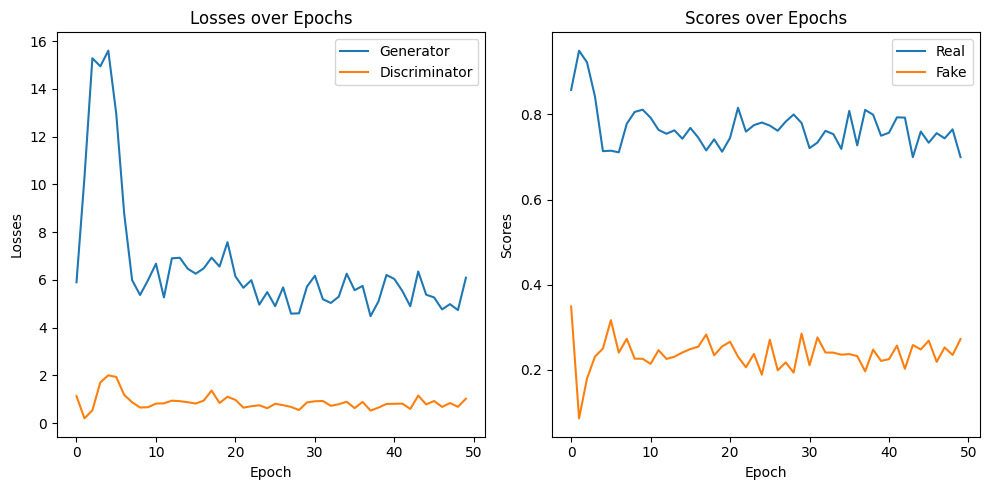

In [ ]:
df = pd.DataFrame(history)

titles = ['Losses' , 'Scores']
fig, axes  = plt.subplots(1, 2, figsize = (10, 5))

for ax, title in zip(axes, titles):
    if title == 'Losses':
        ax.plot(df['g_losses'], label = 'Generator')
        ax.plot(df['d_losses'], label = 'Discriminator')
    else:
        ax.plot(df['r_scores'], label = 'Real')
        ax.plot(df['f_scores'], label = 'Fake')

    ax.legend()
    ax.set_title(f'{title} over Epochs')
    ax.set_xlabel('Epoch')
    ax.set_ylabel(title)

plt.tight_layout()
plt.show()

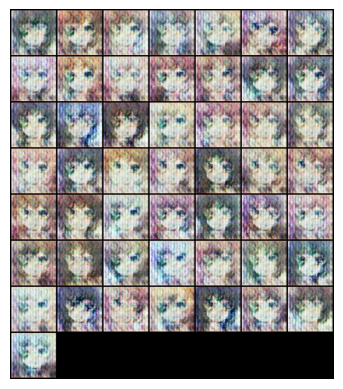

In [ ]:
generator.eval()
images(generate(50))

In [ ]:
animate_images(tr, 'Training Images')